In [2]:
#importing the necessary libaries
from skimage import io
import numpy as np
from matplotlib import pyplot as plt 
from skimage.data import camera
from skimage.util import compare_images
from skimage.filters import roberts,sobel,scharr,prewitt
import os
import h5py
import numpy as np
from PIL import Image
import numpy as np
from matplotlib import pyplot as plt
import cv2
from skimage import exposure, filters
import numpy as np
from sklearn.decomposition import PCA
from skimage import io
import numpy as np
from matplotlib import pyplot as plt 
import glob
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from glob import glob
from sklearn.utils import shuffle


from keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from keras.models import Model
from keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping, TensorBoard
from keras.optimizers import Adam
from keras.metrics import Recall, Precision, Accuracy

C:\ProgramData\anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [3]:
root = "C:/Users/User_ensias/Desktop/"
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm','jpeg')

In [40]:
## augmented data


input_data = os.path.join(root, 'train/image')
X_train = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

#print("Le nombre de donnees de training avant l'operation de l'augmentation : ",len(X_train_paths))
print("Le nombre de donnees de training apres l'operation de l'augmentation : ",len(X_train))


input_data = os.path.join(root, 'test/image')
X_test = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

#print("Le nombre de donnees de testing avant l'operation de l'augmentation : ",len(X_test_paths))
print("Le nombre de donnees de testing apres l'operation de l'augmentation : ",len(X_test))

Le nombre de donnees de training apres l'operation de l'augmentation :  4260
Le nombre de donnees de testing apres l'operation de l'augmentation :  54


In [41]:
# target list

output_data_train = os.path.join(root, 'train/mask')
y_train = sorted(
    [
        os.path.join(output_data_train, fname)
        for fname in os.listdir(output_data_train)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

# target list

output_data_test = os.path.join(root, 'test/mask')
y_test = sorted(
    [
        os.path.join(output_data_test, fname)
        for fname in os.listdir(output_data_test)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [5]:
def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

def bce_dice_loss(y_true, y_pred):
        return binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

In [42]:
X_train_paths = X_train
X_test_paths = X_test
y_train_paths = y_train
y_test_paths = y_test

In [45]:
def load_images_X(paths):
    images = []
    for path in paths:
        img = cv2.imread(path)
        img = cv2.resize(img, (256, 256))  # Redimensionnez l'image si nécessaire
        img_array = np.array(img)
        img_array = img_array.astype('float32') / 255.0
        images.append(img_array)
    return np.array(images)

def load_images_y(paths):
    images = []
    for path in paths:
        img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
        img = cv2.resize(img, (256, 256))  # Redimensionnez l'image si nécessaire
        img_array = np.array(img)
        img_array = img_array.astype('float32') / 255.0
        images.append(img_array)
    return np.array(images)


In [46]:
# Chargement des images non segmentées
X_train = load_images_X(X_train_paths)
X_test = load_images_X(X_test_paths)

# Chargement des images segmentées correspondantes
y_train = load_images_y(y_train_paths)
y_test = load_images_y(y_test_paths)

## ITERNET

In [55]:
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, concatenate, Conv2DTranspose

def iternet(input_shape):
    inputs = Input(input_shape)

    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(512, 3, activation='relu', padding='same')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same')(conv4)

    up5 = concatenate([Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv4), conv3], axis=3)
    conv5 = Conv2D(256, 3, activation='relu', padding='same')(up5)
    conv5 = Conv2D(256, 3, activation='relu', padding='same')(conv5)

    up6 = concatenate([Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv5), conv2], axis=3)
    conv6 = Conv2D(128, 3, activation='relu', padding='same')(up6)
    conv6 = Conv2D(128, 3, activation='relu', padding='same')(conv6)

    up7 = concatenate([Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv6), conv1], axis=3)
    conv7 = Conv2D(64, 3, activation='relu', padding='same')(up7)
    conv7 = Conv2D(64, 3, activation='relu', padding='same')(conv7)

    output = Conv2D(1, 1, activation='sigmoid')(conv7)

    model = Model(inputs=inputs, outputs=output)
    return model


In [57]:
# Create the ITERNet model
input_shape = (256, 256, 3)
model = iternet(input_shape)

# Print the model summary
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_65 (Conv2D)             (None, 256, 256, 64  1792        ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_66 (Conv2D)             (None, 256, 256, 64  36928       ['conv2d_65[0][0]']              
                                )                                                           

In [58]:
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import Adam

# Compilation du modèle
model.compile(optimizer=Adam(learning_rate=0.001),
              loss=BinaryCrossentropy(),
              metrics=[dice_coef, iou, Recall(), Precision(), Accuracy()])

In [61]:
# Entraînement du modèle
#model.fit(train_x, train_y, batch_size=10, epochs=10, validation_data=(valid_x, valid_y))

model.fit(train_dataset,
          epochs=num_epochs,
          validation_data=valid_dataset,
          steps_per_epoch=train_steps,
         validation_steps=valid_setps)

Epoch 1/10
426/426 [==============================] - 6687s 16s/step - loss: 0.1970 - dice_coef: 0.2504 - iou: 0.1465 - recall_2: 0.0731 - precision_2: 0.9025 - accuracy: 3.5819e-09 - val_loss: 0.1655 - val_dice_coef: 0.4341 - val_iou: 0.2792 - val_recall_2: 0.1870 - val_precision_2: 0.9443 - val_accuracy: 0.0000e+00
Epoch 2/10
426/426 [==============================] - 6688s 16s/step - loss: 0.1504 - dice_coef: 0.4161 - iou: 0.2640 - recall_2: 0.1591 - precision_2: 0.9421 - accuracy: 7.1638e-09 - val_loss: 0.1487 - val_dice_coef: 0.4887 - val_iou: 0.3276 - val_recall_2: 0.1905 - val_precision_2: 0.9591 - val_accuracy: 0.0000e+00
Epoch 3/10
426/426 [==============================] - 6687s 16s/step - loss: 0.1404 - dice_coef: 0.4555 - iou: 0.2961 - recall_2: 0.1664 - precision_2: 0.9479 - accuracy: 3.5819e-09 - val_loss: 0.1489 - val_dice_coef: 0.4873 - val_iou: 0.3257 - val_recall_2: 0.1572 - val_precision_2: 0.9757 - val_accuracy: 0.0000e+00
Epoch 4/10
426/426 [=======================

In [63]:
model.save("C:/Users/User_ensias/Desktop/DATA/IterNet.h5")

## Model Load

In [30]:
import tensorflow as tf

import tensorflow.keras as keras
from tensorflow.keras.models import load_model

# Définition de la fonction dice_coef
def dice_coef(y_true, y_pred):
    intersection = np.sum(y_true * y_pred)
    smooth = 1e-5  # Pour éviter une division par zéro
    dice = (2.0 * intersection + smooth) / (np.sum(y_true) + np.sum(y_pred) + smooth)
    return dice

def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

# Charger le modèle en utilisant keras.utils.custom_object_scope
with keras.utils.custom_object_scope({'dice_coef': dice_coef,'iou': iou}):
    model = load_model('C:/Users/User_ensias/Desktop/DATA/IterNet.h5')

# Load the saved model
#model = tf.keras.models.load_model('/content/drive/MyDrive/PFA/UNET_1.h5')

In [57]:
y_predict = model.predict(X_test)

2/2 [==============================] - 33s 12s/step


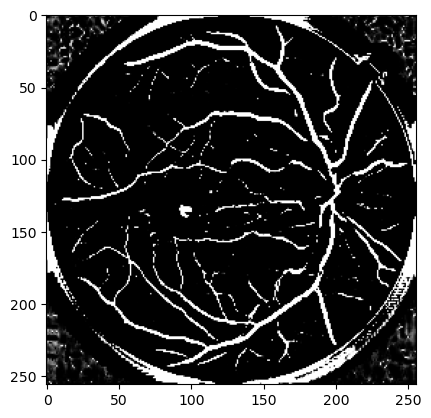

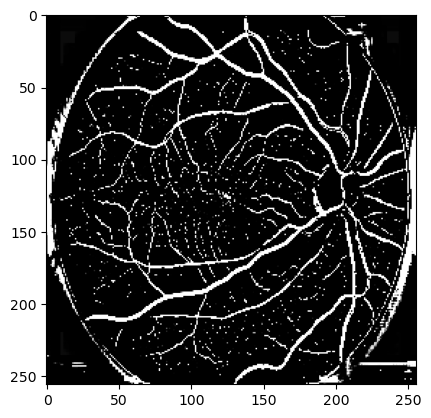

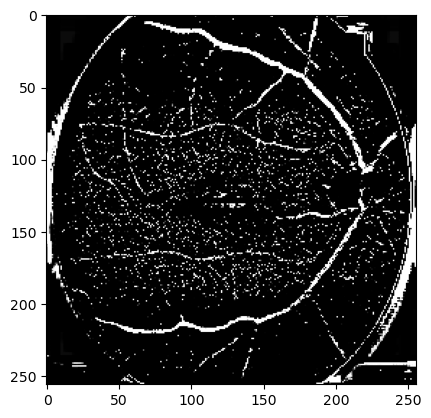

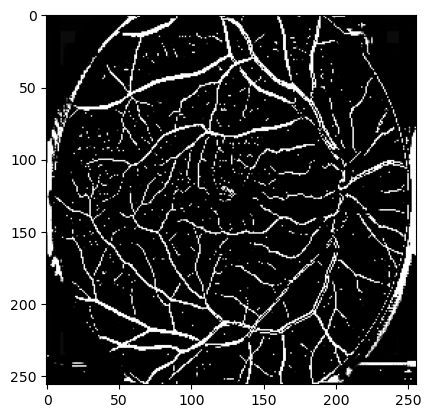

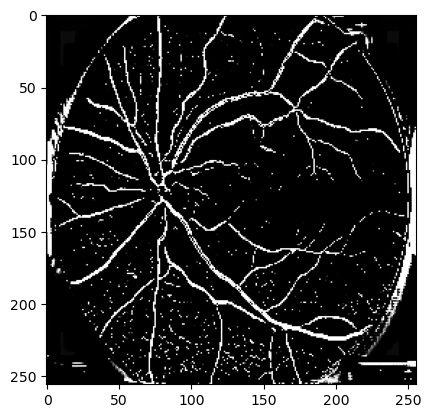

...

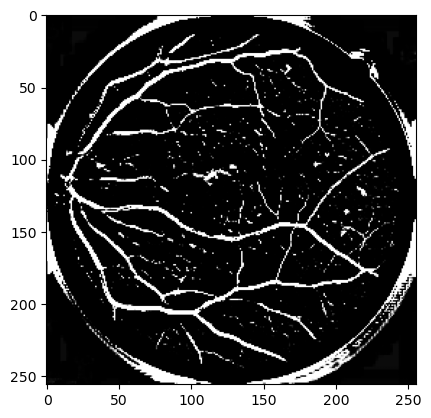

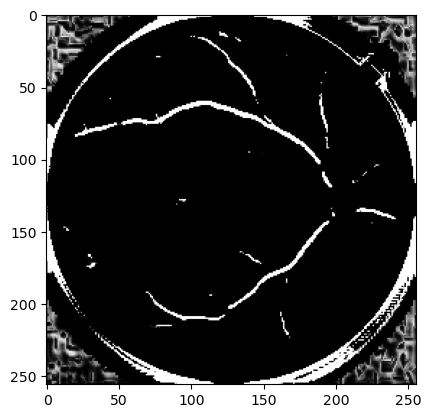

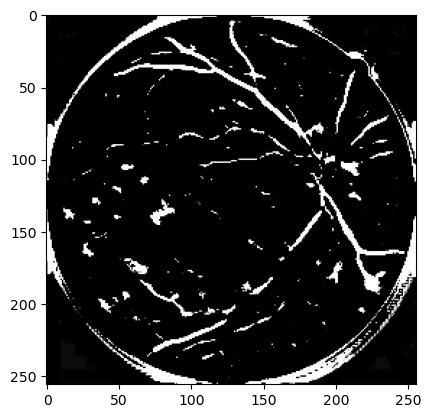

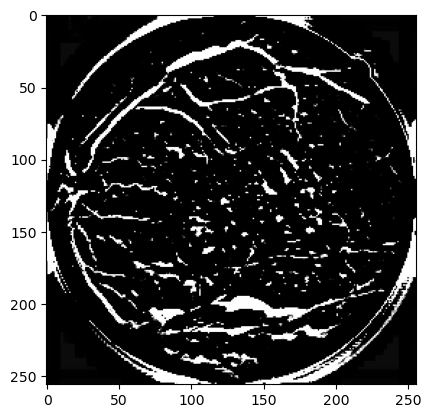

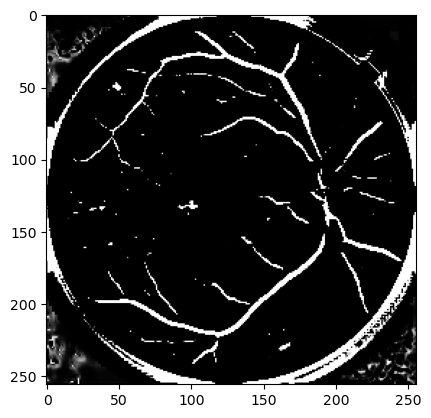

In [19]:
# Afficher les masques prédits
for i in range(len(X_test_re)):
    predicted_mask = y_predict[i]
    #predicted_mask = y_predict.reshape((512,512))
    plt.imshow(predicted_mask, cmap='gray')
    plt.show()

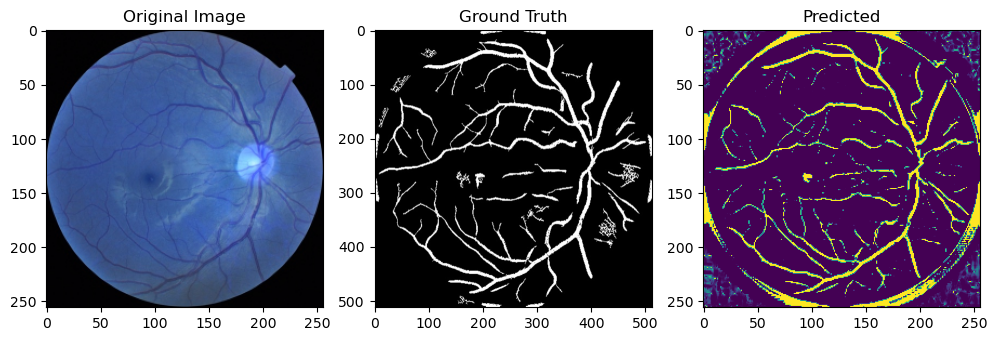

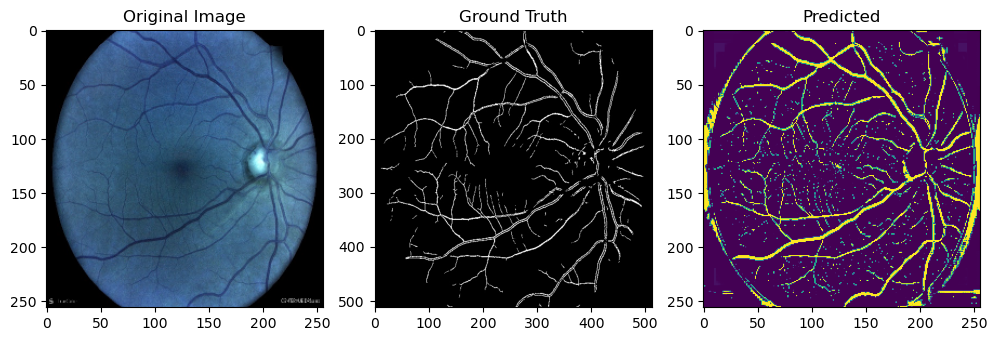

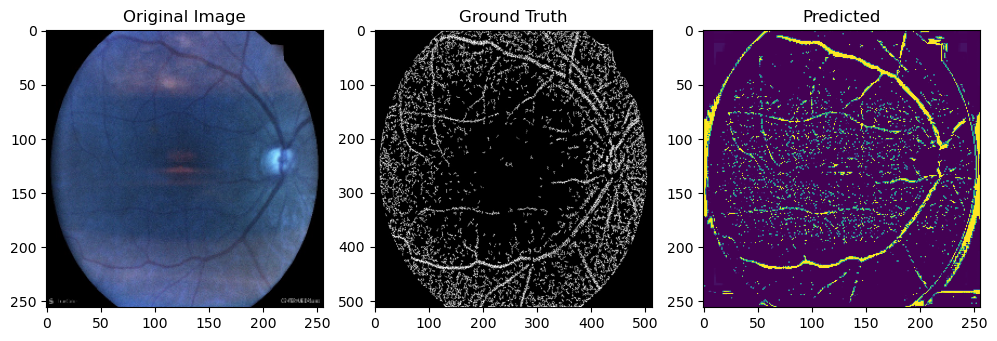

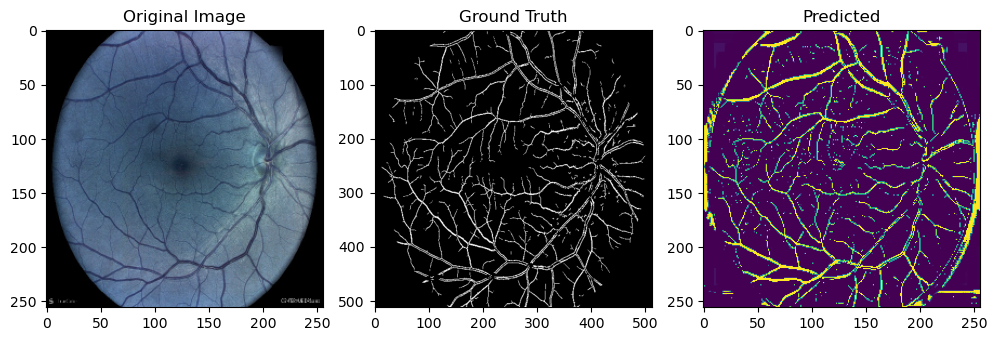

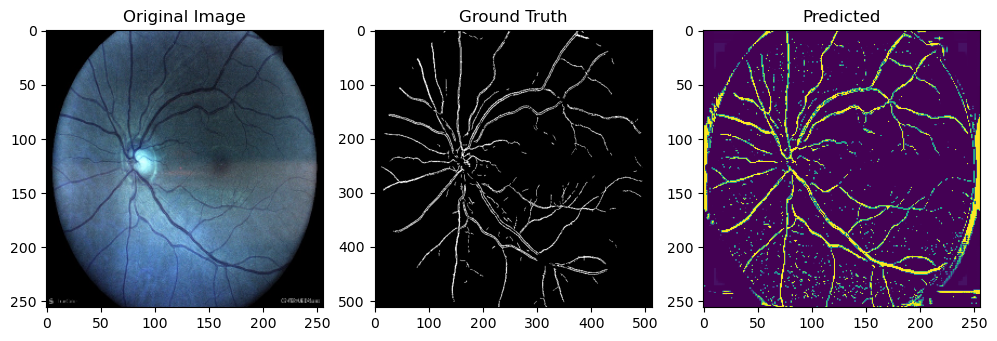

...

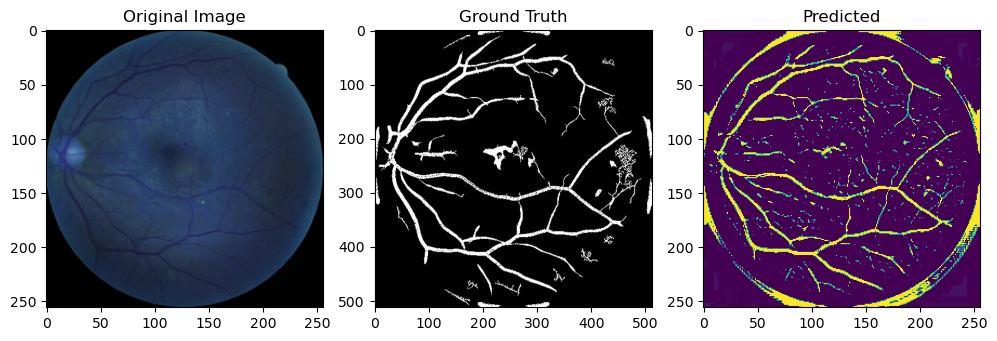

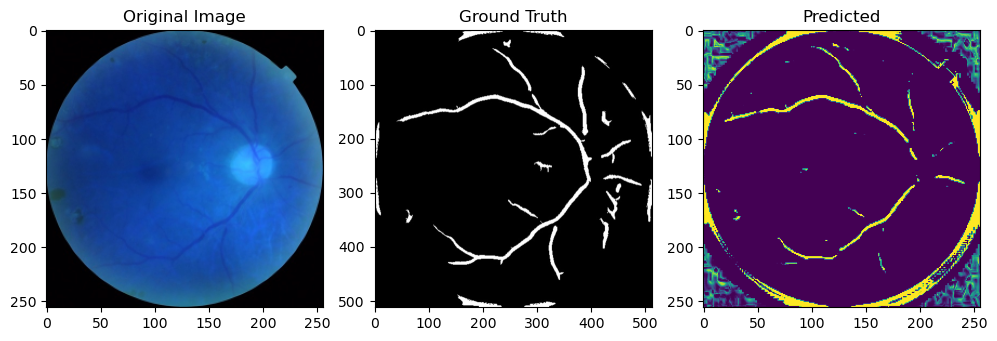

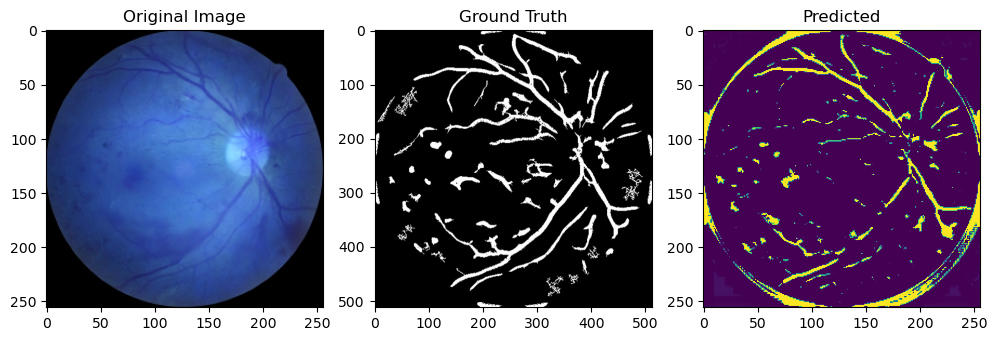

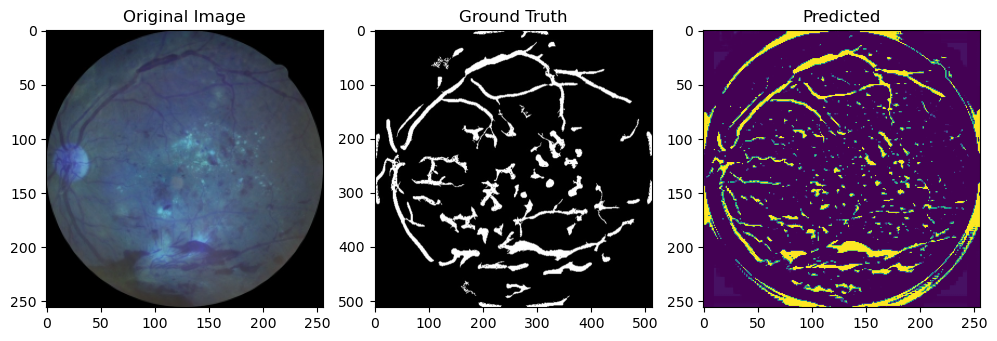

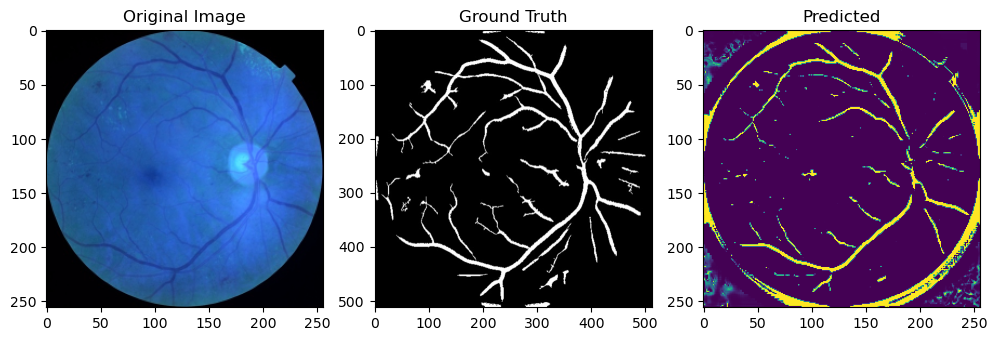

In [20]:

num_images = len(X_test_re)

# Iterate over the images and plot them
for i in range(num_images):
    plt.figure(figsize=(10, 5))

    # Plot the original image
    plt.subplot(1, 3, 1)
    plt.imshow(X_test_re[i])
    plt.title("Original Image")

    # Plot the ground truth label
    plt.subplot(1, 3, 2)
    plt.imshow(cv2.imread(y_test[i]))
    plt.title("Ground Truth")

    # Plot the predicted label
    plt.subplot(1, 3, 3)
    plt.imshow(y_predict[i])
    plt.title("Predicted")

    plt.tight_layout()
    plt.show()

In [60]:
import numpy as np
from sklearn.metrics import jaccard_score, precision_score, recall_score, accuracy_score

# Convertir les prédictions en masques binaires (0 et 1)
y_pred_binary = np.round(y_predict).astype(np.uint8)
y_true_binary = np.round(y_test).astype(np.uint8)

# Supprimer la dimension supplémentaire de y_pred_binary
y_pred_binary = np.squeeze(y_pred_binary, axis=3)

# Calculer l'Intersection over Union (IoU)
#iou = iou(y_true_binary.flatten(), y_pred_binary.flatten())


# Calculer le Dice Coefficient
dice = 2 * np.sum(y_true_binary * y_pred_binary) / (np.sum(y_true_binary) + np.sum(y_pred_binary))

# Calculer la précision et la sensibilité
precision = precision_score(y_true_binary.flatten(), y_pred_binary.flatten(),average = 'weighted')
recall = recall_score(y_true_binary.flatten(), y_pred_binary.flatten(), average = 'macro')

# Calculer l'exactitude (accuracy)
accuracy = accuracy_score(y_true_binary.flatten(), y_pred_binary.flatten())

print("Intersection over Union (IoU):", iou)
print("Dice Coefficient:", dice)
print("Précision:", precision)
print("Sensibilité:", recall)
print("Exactitude (Accuracy):", accuracy)



Intersection over Union (IoU): tf.Tensor(0.5264189, shape=(), dtype=float32)
Dice Coefficient: 0.6897436918399708
Précision: 0.9601852570195462
Sensibilité: 0.7818046839562609
Exactitude (Accuracy): 0.9625699078595197


In [61]:
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error, jaccard_score

# Calculer le Mean Squared Error (MSE)
mse = mean_squared_error(y_true_binary.flatten(), y_pred_binary.flatten())

# Calculer le Mean Absolute Error (MAE)
mae = mean_absolute_error(y_true_binary.flatten(), y_pred_binary.flatten())

# Calculer le Jaccard Score
#jaccard = jaccard_score(y_test_2d, y_pred_2d)

# Afficher les résultats
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
#print("Jaccard Score:", jaccard)


Mean Squared Error: 0.03743009214048033
Mean Absolute Error: 8.004931131998697
